Import the required libraries

In [1110]:
import pandas as pd
import xgboost as xgb
from sklearn.metrics import r2_score
from datetime import timedelta
import matplotlib.pyplot as plt
import joblib
%matplotlib inline
from prophet import Prophet
import numpy as np
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, cross_val_predict
from xgboost import XGBRegressor
from ydata_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder,MinMaxScaler, OneHotEncoder, StandardScaler
from category_encoders import CountEncoder
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
import warnings
warnings.filterwarnings('ignore')

Read the train data into the notebook; travel_from co-ordinates were merged onto the original train dataset

In [1025]:
data = pd.read_csv('merged_data_coordinates.csv')
data.drop(['travel_to_y', 'travel_to_x'],axis=1, inplace=True)
data.head()

,Unnamed: 0,ride_id,seat_number,payment_method,payment_receipt,travel_date,travel_time,travel_from,car_type,max_capacity,lat,lng
0,0,1442,15A,Mpesa,UZUEHCBUSO,17/10/2017,07:15,Migori,Bus,49,-1.0634,34.4731
1,1,5437,14A,Mpesa,TIHLBUSGTE,19/11/2017,07:12,Migori,Bus,49,-1.0634,34.4731
2,2,5710,8B,Mpesa,EQX8Q5G19O,26/11/2017,07:05,Keroka,Bus,49,-0.7771,34.9458
3,3,5777,19A,Mpesa,SGP18CL0ME,27/11/2017,07:10,Homa Bay,Bus,49,-0.5167,34.4500
4,4,5778,11A,Mpesa,BM97HFRGL9,27/11/2017,07:12,Migori,Bus,49,-1.0634,34.4731


In [1026]:
data.shape

(51645, 12)

Calculate the distance from upcountry cities to Nairobi and create a new column called distance_to_nairobi in the dataset

In [1027]:
# Function to calculate distance using Haversine formula
# Latitude and longitude of the nairobi city
target_latitude = 1.2921
target_longitude = 36.8219
def haversine_distance(lat1, lon1, lat2, lon2):

    R = 6371  # Radius of Earth in kilometers
    dlat = np.radians(lat2 - lat1)
    dlon = np.radians(lon2 - lon1)
    a = np.sin(dlat / 2) * np.sin(dlat / 2) + np.cos(np.radians(lat1)) * np.cos(np.radians(lat2)) * np.sin(dlon / 2) * np.sin(dlon / 2)
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    distance = R * c
    return distance

# Calculate distances to the target city
data['distance_to_nairobi'] = haversine_distance(data['lat'], data['lng'], target_latitude, target_longitude)

# Drop the individual date, time, and hour columns if needed
data.drop(["Unnamed: 0"], axis=1, inplace=True)

In [1028]:
data.columns

Index(['ride_id', 'seat_number', 'payment_method', 'payment_receipt',
       'travel_date', 'travel_time', 'travel_from', 'car_type', 'max_capacity',
       'lat', 'lng', 'distance_to_nairobi'],
      dtype='object')

In [51]:
data.shape

(51645, 12)

Extract date and time features from travel_date and travel_time and create new columns; date, month, day, hour, day_of_week, quarter, minute and is_weekend into the dataset

In [1029]:
def extract_date_time_features(data):
    data['travel_date'] = pd.to_datetime(data['travel_date'])
    data['travel_time'] = pd.to_datetime(data['travel_time'])
    data["date"]= data["travel_date"] + pd.to_timedelta(data["travel_time"].dt.hour, unit='h') + pd.to_timedelta(data["travel_time"].dt.minute, unit='m')
    data['month'] = data['travel_date'].dt.month
    data['day'] = data['travel_date'].dt.day
    data['hour'] = data['travel_time'].dt.hour
    data['day_of_week'] = data['travel_date'].dt.dayofweek
    data["quarter"]=data["travel_date"].dt.quarter
    data["minute"]=data["travel_date"].dt.minute
    data["is_weekend"]=data["day_of_week"].apply( lambda x : 1 if x  in [5,6] else 0 )
    return data

data = extract_date_time_features(data)
data.head()



,ride_id,seat_number,payment_method,payment_receipt,travel_date,travel_time,travel_from,car_type,max_capacity,lat,lng,distance_to_nairobi,date,month,day,hour,day_of_week,quarter,minute,is_weekend
0,1442,15A,Mpesa,UZUEHCBUSO,2017-10-17,2023-08-27 07:15:00,Migori,Bus,49,-1.0634,34.4731,369.870542,2017-10-17 07:15:00,10,17,7,1,4,0,0
1,5437,14A,Mpesa,TIHLBUSGTE,2017-11-19,2023-08-27 07:12:00,Migori,Bus,49,-1.0634,34.4731,369.870542,2017-11-19 07:12:00,11,19,7,6,4,0,1
2,5710,8B,Mpesa,EQX8Q5G19O,2017-11-26,2023-08-27 07:05:00,Keroka,Bus,49,-0.7771,34.9458,310.568170,2017-11-26 07:05:00,11,26,7,6,4,0,1
3,5777,19A,Mpesa,SGP18CL0ME,2017-11-27,2023-08-27 07:10:00,Homa Bay,Bus,49,-0.5167,34.4500,331.669362,2017-11-27 07:10:00,11,27,7,0,4,0,0
4,5778,11A,Mpesa,BM97HFRGL9,2017-11-27,2023-08-27 07:12:00,Migori,Bus,49,-1.0634,34.4731,369.870542,2017-11-27 07:12:00,11,27,7,0,4,0,0


View how the new dataframe looks with the newly created features

In [1030]:
data.head()

,ride_id,seat_number,payment_method,payment_receipt,travel_date,travel_time,travel_from,car_type,max_capacity,lat,lng,distance_to_nairobi,date,month,day,hour,day_of_week,quarter,minute,is_weekend
0,1442,15A,Mpesa,UZUEHCBUSO,2017-10-17,2023-08-27 07:15:00,Migori,Bus,49,-1.0634,34.4731,369.870542,2017-10-17 07:15:00,10,17,7,1,4,0,0
1,5437,14A,Mpesa,TIHLBUSGTE,2017-11-19,2023-08-27 07:12:00,Migori,Bus,49,-1.0634,34.4731,369.870542,2017-11-19 07:12:00,11,19,7,6,4,0,1
2,5710,8B,Mpesa,EQX8Q5G19O,2017-11-26,2023-08-27 07:05:00,Keroka,Bus,49,-0.7771,34.9458,310.568170,2017-11-26 07:05:00,11,26,7,6,4,0,1
3,5777,19A,Mpesa,SGP18CL0ME,2017-11-27,2023-08-27 07:10:00,Homa Bay,Bus,49,-0.5167,34.4500,331.669362,2017-11-27 07:10:00,11,27,7,0,4,0,0
4,5778,11A,Mpesa,BM97HFRGL9,2017-11-27,2023-08-27 07:12:00,Migori,Bus,49,-1.0634,34.4731,369.870542,2017-11-27 07:12:00,11,27,7,0,4,0,0


In [1031]:
data.columns

Index(['ride_id', 'seat_number', 'payment_method', 'payment_receipt',
       'travel_date', 'travel_time', 'travel_from', 'car_type', 'max_capacity',
       'lat', 'lng', 'distance_to_nairobi', 'date', 'month', 'day', 'hour',
       'day_of_week', 'quarter', 'minute', 'is_weekend'],
      dtype='object')

In [1032]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51645 entries, 0 to 51644
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ride_id              51645 non-null  int64         
 1   seat_number          51645 non-null  object        
 2   payment_method       51645 non-null  object        
 3   payment_receipt      51645 non-null  object        
 4   travel_date          51645 non-null  datetime64[ns]
 5   travel_time          51645 non-null  datetime64[ns]
 6   travel_from          51645 non-null  object        
 7   car_type             51645 non-null  object        
 8   max_capacity         51645 non-null  int64         
 9   lat                  51645 non-null  float64       
 10  lng                  51645 non-null  float64       
 11  distance_to_nairobi  51645 non-null  float64       
 12  date                 51645 non-null  datetime64[ns]
 13  month                51645 non-

Calculate the ride ride_occurrences and also use the ride_id variable to calculate the number of tickets sold, then drop the duplicates

In [1034]:
data_copy = data.copy()
ride_occurrences = data_copy['ride_id'].value_counts().reset_index()
#print(ride_occurrences)

ride_occurrences.rename(columns={'index': 'ride_id', 'ride_id': 'number_of_tickets'}, inplace=True)
data_copy = pd.merge(data_copy, ride_occurrences, on='ride_id', how='left')

# Drop duplicates based on 'ride_id'
data_copy.drop_duplicates(subset='ride_id', inplace=True)


Calculating the time difference between buses using the upcountry cities and date variabes..

In [1036]:
def find_difference_between_bus(data):

  data_copy.sort_values(["travel_from","date"],inplace=True,ascending=True)
  data_copy["Time_gap_btw_0_1_next_bus"]=(data_copy["date"]-data_copy.groupby(["travel_from"]).date.shift(-1)).dt.total_seconds()/3600
  data_copy["Time_gap_btw_0_1_previous_bus"]=(data_copy["date"]-data_copy.groupby(["travel_from"]).date.shift(1)).dt.total_seconds()/3600
  data_copy["Time_gap_btw_0_2_next_bus"]=(data_copy["date"]-data_copy.groupby(["travel_from"]).date.shift(-2)).dt.total_seconds()/3600
  data_copy["Time_gap_btw_0_2_previous_bus"]=(data_copy["date"]-data_copy.groupby(["travel_from"]).date.shift(2)).dt.total_seconds()/3600
  data_copy["Time_gap_btw_0_3_next_bus"]=(data_copy["date"]-data_copy.groupby(["travel_from"]).date.shift(-3)).dt.total_seconds()/3600
  data_copy["Time_gap_btw_0_3_previous_bus"]=(data_copy["date"]-data_copy.groupby(["travel_from"]).date.shift(3)).dt.total_seconds()/3600
  data_copy["Time_gap_btw_next_previous_bus"]=(data_copy.groupby(["travel_from"]).date.shift(-1)-data.groupby(["travel_from"]).date.shift(1)).dt.total_seconds()/3600
  cols=["Time_gap_btw_0_1_next_bus", "Time_gap_btw_0_1_previous_bus", "Time_gap_btw_0_2_next_bus","Time_gap_btw_0_2_previous_bus",
      "Time_gap_btw_0_3_next_bus", "Time_gap_btw_0_3_previous_bus","Time_gap_btw_next_previous_bus"]
  data_copy[cols]=data_copy.groupby(["travel_from"])[cols].fillna(method="ffill")
  data_copy[cols]=data_copy.groupby(["travel_from"])[cols].fillna(method="backfill")

  return data


In [1037]:
data_copy = find_difference_between_bus(data_copy)

In [1038]:
data_copy.columns

Index(['ride_id', 'seat_number', 'payment_method', 'payment_receipt',
       'travel_date', 'travel_time', 'travel_from', 'car_type', 'max_capacity',
       'lat', 'lng', 'distance_to_nairobi', 'date', 'month', 'day', 'hour',
       'day_of_week', 'quarter', 'minute', 'is_weekend', 'number_of_tickets',
       'Time_gap_btw_0_1_next_bus', 'Time_gap_btw_0_1_previous_bus',
       'Time_gap_btw_0_2_next_bus', 'Time_gap_btw_0_2_previous_bus',
       'Time_gap_btw_0_3_next_bus', 'Time_gap_btw_0_3_previous_bus',
       'Time_gap_btw_next_previous_bus'],
      dtype='object')

In [1039]:
data_copy.shape

(6249, 28)

Creating a travel_from_time variable from the different upcountry cities to nairobi

In [1040]:
time = {'Migori': 7*60+8 , 'Keroka': 5*60, 'Homa Bay':7*60, 'Kisii':5*60+34, 'Keumbu':5*60+20, 'Rongo':6*60+21,
'Kijauri':60*4+50,'Oyugis':5*60+50, 'Awendo':6*60+38, 'Sirare':7*60+30, 'Nyachenge':6*60+10, 'Kehancha':7*60+10,
'Kendu Bay':6*60+10, 'Sori':7*60+30, 'Rodi':6*60+40, 'Mbita':7*60+23, 'Ndhiwa': 7*60}
data_copy["travel_from_time"]=data_copy.travel_from.map(time)


In [1041]:
data_copy.head()

,ride_id,seat_number,payment_method,payment_receipt,travel_date,travel_time,travel_from,car_type,max_capacity,lat,...,is_weekend,number_of_tickets,Time_gap_btw_0_1_next_bus,Time_gap_btw_0_1_previous_bus,Time_gap_btw_0_2_next_bus,Time_gap_btw_0_2_previous_bus,Time_gap_btw_0_3_next_bus,Time_gap_btw_0_3_previous_bus,Time_gap_btw_next_previous_bus,travel_from_time
2152,6654,24B,Mpesa,UMAPNYPBAS,2017-05-12,2023-08-27 07:08:00,Awendo,Bus,49,-0.9017,...,0,2,-5688.000000,5688.000000,-5688.066667,5688.066667,-5688.083333,5688.083333,5688.066667,398
44611,12926,25,Mpesa,NOXLCPZ2MO,2018-01-04,2023-08-27 07:08:00,Awendo,Bus,49,-0.9017,...,0,20,-0.066667,5688.000000,-0.083333,5688.066667,-0.866667,5688.083333,5688.066667,398
44617,12929,16A,Mpesa,VSJSFSMOFG,2018-01-04,2023-08-27 07:12:00,Awendo,Bus,49,-0.9017,...,0,2,-0.016667,0.066667,-0.800000,5688.066667,-215.933333,5688.083333,0.083333,398
44650,12935,21B,Mpesa,2MLD47XLVU,2018-01-04,2023-08-27 07:13:00,Awendo,Bus,49,-0.9017,...,0,9,-0.783333,0.016667,-215.916667,0.083333,-216.033333,5688.083333,0.800000,398
44609,12924,16B,Mpesa,6KYCTDYHDJ,2018-01-04,2023-08-27 08:00:00,Awendo,Bus,49,-0.9017,...,0,15,-215.133333,0.783333,-215.250000,0.800000,-239.133333,0.866667,215.916667,398


Create a speed variable from the distances and time features 

In [1042]:
data_copy["Speed"]=data_copy.travel_from_time/data_copy.distance_to_nairobi

In [1043]:
time = {'Migori': 7*60+8 , 'Keroka': 5*60, 'Homa Bay':7*60, 'Kisii':5*60+34, 'Keumbu':5*60+20, 'Rongo':6*60+21,
'Kijauri':60*4+50,'Oyugis':5*60+50, 'Awendo':6*60+38, 'Sirare':7*60+30, 'Nyachenge':6*60+10, 'Kehancha':7*60+10,
'Kendu Bay':6*60+10, 'Sori':7*60+30, 'Rodi':6*60+40, 'Mbita':7*60+23, 'Ndhiwa': 7*60}
for key in time.keys():
    time[key]=timedelta( minutes=time[key])

#find the date of traveling from origin
data_copy["Date_of_traveling_from_origin"]=data_copy.travel_from.map(time)

# find the date of arrival at distination
data_copy["arrival_date"]=data_copy.date+ data_copy.Date_of_traveling_from_origin
data_copy["hod_arrived_date"]=data_copy["arrival_date"].dt.hour
data_copy["minute_arrived_date"]=data_copy["arrival_date"].dt.minute
del data_copy["Date_of_traveling_from_origin"],data_copy["arrival_date"]
data_copy["is_rush_hour"]=0
data_copy.loc[data_copy.hod_arrived_date.between(7,17),"is_rush_hour"]=1

In [1044]:
data_copy.columns

Index(['ride_id', 'seat_number', 'payment_method', 'payment_receipt',
       'travel_date', 'travel_time', 'travel_from', 'car_type', 'max_capacity',
       'lat', 'lng', 'distance_to_nairobi', 'date', 'month', 'day', 'hour',
       'day_of_week', 'quarter', 'minute', 'is_weekend', 'number_of_tickets',
       'Time_gap_btw_0_1_next_bus', 'Time_gap_btw_0_1_previous_bus',
       'Time_gap_btw_0_2_next_bus', 'Time_gap_btw_0_2_previous_bus',
       'Time_gap_btw_0_3_next_bus', 'Time_gap_btw_0_3_previous_bus',
       'Time_gap_btw_next_previous_bus', 'travel_from_time', 'Speed',
       'hod_arrived_date', 'minute_arrived_date', 'is_rush_hour'],
      dtype='object')

Drop some unwanted columns

In [1045]:
cols_drop=["seat_number","payment_method","payment_receipt","travel_date","travel_time","date","day"]
data_copy_1 = data_copy.copy()
data_copy_1.drop(columns=cols_drop,inplace=True)

In [1046]:
data_copy_1.shape

(6249, 26)

In [1047]:
data_copy.shape

(6249, 33)

In [1048]:
from sklearn import preprocessing
label_encoder_ride_id = LabelEncoder()
label_enc = {'Bus':1,'shuttle':0}
#data_copy_1['ride_id'] = label_encoder_ride_id.fit_transform(data_copy_1['ride_id'])
data_copy_1 = pd.get_dummies(data_copy_1, columns=["day_of_week", "month", "travel_from"])
data_copy_1['car_type'].replace(label_enc, inplace=True)

In [1049]:
data_copy_1.shape

(6249, 59)

In [1050]:
data_copy_1.columns

Index(['ride_id', 'car_type', 'max_capacity', 'lat', 'lng',
       'distance_to_nairobi', 'hour', 'quarter', 'minute', 'is_weekend',
       'number_of_tickets', 'Time_gap_btw_0_1_next_bus',
       'Time_gap_btw_0_1_previous_bus', 'Time_gap_btw_0_2_next_bus',
       'Time_gap_btw_0_2_previous_bus', 'Time_gap_btw_0_3_next_bus',
       'Time_gap_btw_0_3_previous_bus', 'Time_gap_btw_next_previous_bus',
       'travel_from_time', 'Speed', 'hod_arrived_date', 'minute_arrived_date',
       'is_rush_hour', 'day_of_week_0', 'day_of_week_1', 'day_of_week_2',
       'day_of_week_3', 'day_of_week_4', 'day_of_week_5', 'day_of_week_6',
       'month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6',
       'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12',
       'travel_from_Awendo', 'travel_from_Homa Bay', 'travel_from_Kehancha',
       'travel_from_Kendu Bay', 'travel_from_Keroka', 'travel_from_Keumbu',
       'travel_from_Kijauri', 'travel_from_Kisii', 'travel_from_Mbit

In [1051]:
from ydata_profiling import ProfileReport
data_profile = ProfileReport(data_copy_1, title='Dataset Profiling', explorative=True)
data_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [1052]:
data_copy_1.columns

Index(['ride_id', 'car_type', 'max_capacity', 'lat', 'lng',
       'distance_to_nairobi', 'hour', 'quarter', 'minute', 'is_weekend',
       'number_of_tickets', 'Time_gap_btw_0_1_next_bus',
       'Time_gap_btw_0_1_previous_bus', 'Time_gap_btw_0_2_next_bus',
       'Time_gap_btw_0_2_previous_bus', 'Time_gap_btw_0_3_next_bus',
       'Time_gap_btw_0_3_previous_bus', 'Time_gap_btw_next_previous_bus',
       'travel_from_time', 'Speed', 'hod_arrived_date', 'minute_arrived_date',
       'is_rush_hour', 'day_of_week_0', 'day_of_week_1', 'day_of_week_2',
       'day_of_week_3', 'day_of_week_4', 'day_of_week_5', 'day_of_week_6',
       'month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6',
       'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12',
       'travel_from_Awendo', 'travel_from_Homa Bay', 'travel_from_Kehancha',
       'travel_from_Kendu Bay', 'travel_from_Keroka', 'travel_from_Keumbu',
       'travel_from_Kijauri', 'travel_from_Kisii', 'travel_from_Mbit

In [1053]:
cols_to_exclude = ['number_of_tickets']
X = data_copy_1.drop(columns=cols_to_exclude)
y = data_copy_1['number_of_tickets'].copy()


# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)

# Initialize the XGBoost model
xgb_model = xgb.XGBRegressor()

# Define the hyperparameter grid
param_grid = {
    'max_depth': [5, 10],
    'learning_rate': [0.01, 0.1],
    'n_estimators': [50, 100],

}

# Initialize GridSearchCV
grid_search = GridSearchCV(xgb_model, param_grid, scoring='neg_mean_absolute_error', cv=5)

# Perform grid search on the training data
grid_search.fit(X_train, y_train)

# Get the best hyperparameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

# Predict using the best estimator
y_pred_train = best_estimator.predict(X_train)
y_pred_test = best_estimator.predict(X_test)

# Calculate MAE for both train and test sets
mae_train = mean_absolute_error(y_train, y_pred_train)
mae_test = mean_absolute_error(y_test, y_pred_test)

# Display results
print("Best Hyperparameters:", best_params)
print(f"Mean Absolute Error (Train): {mae_train:.4f}")
print(f"Mean Absolute Error (Test): {mae_test:.4f}")


Best Hyperparameters: {'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 50}
Mean Absolute Error (Train): 1.1939
Mean Absolute Error (Test): 2.9065


In [1111]:
# Save the model to a file
model_filename = 'xgb_model.pkl'
joblib.dump(best_estimator, model_filename)

['xgb_model.pkl']

In [1054]:
from sklearn.metrics import r2_score

# Calculate R-squared score for the training set
r2_train = r2_score(y_train, y_pred_train)

# Calculate R-squared score for the test set
r2_test = r2_score(y_test, y_pred_test)

# Display the R-squared scores
print(f"R-squared (Train): {r2_train:.4f}")
print(f"R-squared (Test): {r2_test:.4f}")


R-squared (Train): 0.9608
R-squared (Test): 0.7097


Make some predictions on the train data using the model

In [1059]:

ride_ids = X_train["ride_id"]  # Assuming "ride_id" is a column in X_train

# Create a DataFrame to hold the results
ride_predictions_df = pd.DataFrame({
    "ride_id": ride_ids,
    "actual_number_of_tickets": y_train,
    "predicted_number_of_tickets": y_pred_train
})

# Display the DataFrame
ride_predictions_df


,ride_id,actual_number_of_tickets,predicted_number_of_tickets
18854,9166,36,30.409103
14988,8582,11,9.913058
234,5899,1,1.111949
34749,20114,4,4.429396
27177,10601,36,36.518845
...,...,...,...
476,6167,1,1.245591
23200,9878,1,1.816631
47418,13279,6,4.667572
7286,7446,10,6.446073


Make some predictions on the test data using the model

In [1060]:

# Get the "ride_id" column from the original data
ride_ids = X_test["ride_id"]  # Assuming "ride_id" is a column in X_test

# Create a DataFrame to hold the results
ride_predictions_test_df = pd.DataFrame({
    "ride_id": ride_ids,
    "actual_number_of_tickets": y_test,
    "predicted_number_of_tickets": y_pred_test
})

# Display the DataFrame
ride_predictions_test_df


,ride_id,actual_number_of_tickets,predicted_number_of_tickets
33701,11426,8,10.104530
41177,12401,5,9.550522
6979,7400,11,9.159801
31064,11104,1,2.959844
20000,9316,2,2.195363
...,...,...,...
11742,8114,31,28.377253
45532,13047,1,5.899185
27251,10612,11,9.180470
33478,11402,11,5.878659


Display feature importance to the model development

In [1058]:
best_xgb_model = grid_search.best_estimator_

# Get feature importances from the best model
feature_importances = best_xgb_model.feature_importances_

# Create a DataFrame to display feature importances
feature_importance_df = pd.DataFrame({
    "Feature": X_train.columns,
    "Importance": feature_importances
})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by="Importance", ascending=False)

# Display the DataFrame
feature_importance_df


,Feature,Importance
17,travel_from_time,0.626303
19,hod_arrived_date,0.097213
4,lng,0.045406
3,lat,0.025484
10,Time_gap_btw_0_1_next_bus,0.017594
20,minute_arrived_date,0.017522
18,Speed,0.016731
11,Time_gap_btw_0_1_previous_bus,0.012652
16,Time_gap_btw_next_previous_bus,0.010867
12,Time_gap_btw_0_2_next_bus,0.010001


Display the top ten important features on a horizontal bar graph

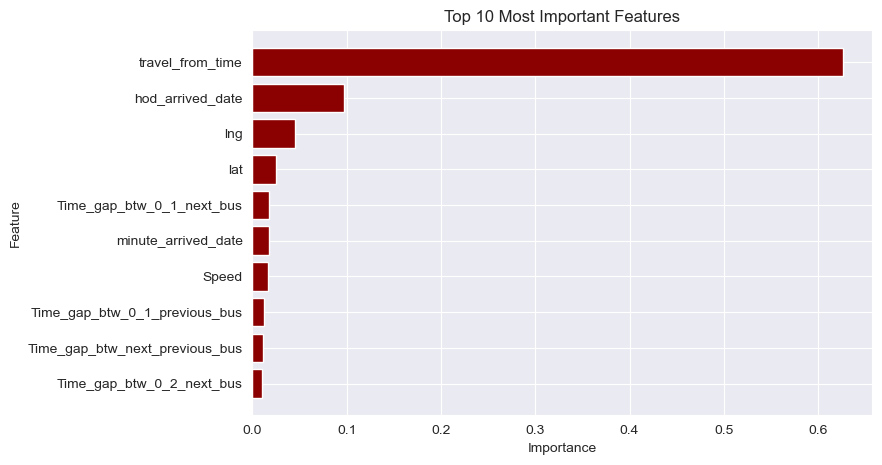

In [1061]:
import matplotlib.pyplot as plt
sns.set_style('darkgrid')

# Assuming you have already defined feature_importance_df

# Select the top 10 most important features
top_10_features = feature_importance_df.head(10)

# Create a bar graph of the top 10 most important features
plt.figure(figsize=(8, 5))
plt.barh(top_10_features["Feature"], top_10_features["Importance"], color='darkred')
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Top 10 Most Important Features")
plt.gca().invert_yaxis()  # Invert y-axis to show most important features at the top
plt.show()


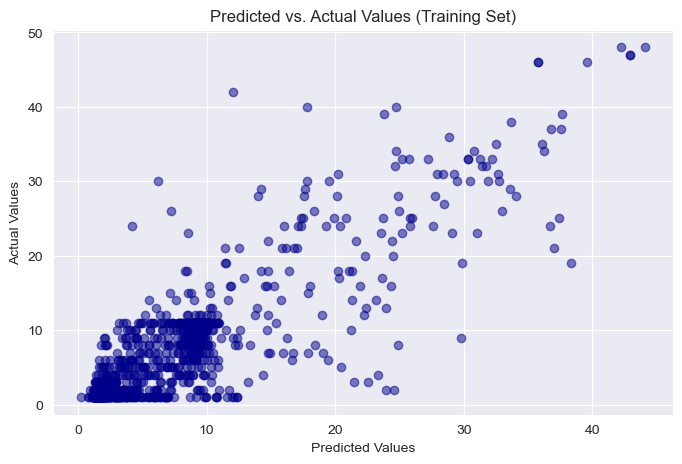

In [1066]:
sns.set_style('darkgrid')
plt.figure(figsize=(8, 5))
plt.scatter(y_pred_test, y_test, alpha=0.5, color='darkblue')
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.title("Predicted vs. Actual Values (Training Set)")
plt.show()

In [1067]:
X_test.head()

,ride_id,car_type,max_capacity,lat,lng,distance_to_nairobi,hour,quarter,minute,is_weekend,...,travel_from_Kisii,travel_from_Mbita,travel_from_Migori,travel_from_Ndhiwa,travel_from_Nyachenge,travel_from_Oyugis,travel_from_Rodi,travel_from_Rongo,travel_from_Sirare,travel_from_Sori
33701,11426,0,11,-0.68330,34.76670,316.964343,8,4,0,0,...,1,0,0,0,0,0,0,0,0,0
41177,12401,1,49,-1.20844,34.60798,371.353790,7,1,0,1,...,0,0,0,0,0,0,0,0,0,0
6979,7400,0,11,-0.68330,34.76670,316.964343,10,1,0,0,...,1,0,0,0,0,0,0,0,0,0
31064,11104,0,11,-0.68330,34.76670,316.964343,5,4,0,1,...,1,0,0,0,0,0,0,0,0,0
20000,9316,1,49,-0.79118,34.76561,325.477208,7,1,0,0,...,0,0,0,0,1,0,0,0,0,0


# Make Predictions with the given Test Dataset

Read the test dataset that has been merged with the co-ordinates of different upcountry cities into the notebook and make it compatible for making predictions by engineering all the features like in the train dataset

In [1068]:
test = pd.read_csv('test_.csv')
test.head()

,ride_id,travel_date,travel_time,travel_from,travel_to,car_type,max_capacity,lat,lng
0,4446,2018-04-27,09:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667
1,13962,2018-04-23,07:10,Homa Bay,Nairobi,Bus,49,-0.5167,34.4500
2,5569,2018-04-24,07:20,Kisii,Nairobi,shuttle,11,-0.6833,34.7667
3,1675,2018-05-01,11:01,Kisii,Nairobi,shuttle,11,-0.6833,34.7667
4,5711,2018-04-22,10:51,Kisii,Nairobi,shuttle,11,-0.6833,34.7667


In [1069]:
#test.drop(['travel_to'],axis=1, inplace=True)
test.head()
test["travel_time_2"]=data["travel_time"]
test = pd.DataFrame(test)
test.head()

,ride_id,travel_date,travel_time,travel_from,travel_to,car_type,max_capacity,lat,lng,travel_time_2
0,4446,2018-04-27,09:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:15:00
1,13962,2018-04-23,07:10,Homa Bay,Nairobi,Bus,49,-0.5167,34.4500,2023-08-27 07:12:00
2,5569,2018-04-24,07:20,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:05:00
3,1675,2018-05-01,11:01,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:10:00
4,5711,2018-04-22,10:51,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:12:00


In [1070]:
# Function to calculate distance using Haversine formula
# Latitude and longitude of the nairobi city
target_latitude = 1.2921
target_longitude = 36.8219
def haversine_distance(lat1, lon1, lat2, lon2):

    R = 6371  # Radius of Earth in kilometers
    dlat = np.radians(lat2 - lat1)
    dlon = np.radians(lon2 - lon1)
    a = np.sin(dlat / 2) * np.sin(dlat / 2) + np.cos(np.radians(lat1)) * np.cos(np.radians(lat2)) * np.sin(dlon / 2) * np.sin(dlon / 2)
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    distance = R * c
    return distance

# Calculate distances to the target city
test['distance_to_nairobi'] = haversine_distance(test['lat'], test['lng'], target_latitude, target_longitude)
test.head()

,ride_id,travel_date,travel_time,travel_from,travel_to,car_type,max_capacity,lat,lng,travel_time_2,distance_to_nairobi
0,4446,2018-04-27,09:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:15:00,316.964343
1,13962,2018-04-23,07:10,Homa Bay,Nairobi,Bus,49,-0.5167,34.4500,2023-08-27 07:12:00,331.669362
2,5569,2018-04-24,07:20,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:05:00,316.964343
3,1675,2018-05-01,11:01,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:10:00,316.964343
4,5711,2018-04-22,10:51,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:12:00,316.964343


In [1071]:
def extract_date_time_features(test):
    test['travel_date'] = pd.to_datetime(test['travel_date'])
    test['travel_time'] = pd.to_datetime(test['travel_time'])
    test["date"]= test["travel_date"] + pd.to_timedelta(test["travel_time"].dt.hour, unit='h') + pd.to_timedelta(test["travel_time"].dt.minute, unit='m')
    test['month'] = test['travel_date'].dt.month
    test['day'] = test['travel_date'].dt.day
    test['hour'] = test['travel_time'].dt.hour
    test['day_of_week'] = test['travel_date'].dt.dayofweek
    test["quarter"]=test["travel_date"].dt.quarter
    test["minute"]=test["travel_date"].dt.minute
    test["is_weekend"]=test["day_of_week"].apply( lambda x : 1 if x  in [5,6] else 0 )
    return test

test= extract_date_time_features(test)
test.head()



,ride_id,travel_date,travel_time,travel_from,travel_to,car_type,max_capacity,lat,lng,travel_time_2,distance_to_nairobi,date,month,day,hour,day_of_week,quarter,minute,is_weekend
0,4446,2018-04-27,2023-08-27 09:00:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:15:00,316.964343,2018-04-27 09:00:00,4,27,9,4,2,0,0
1,13962,2018-04-23,2023-08-27 07:10:00,Homa Bay,Nairobi,Bus,49,-0.5167,34.4500,2023-08-27 07:12:00,331.669362,2018-04-23 07:10:00,4,23,7,0,2,0,0
2,5569,2018-04-24,2023-08-27 07:20:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:05:00,316.964343,2018-04-24 07:20:00,4,24,7,1,2,0,0
3,1675,2018-05-01,2023-08-27 11:01:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:10:00,316.964343,2018-05-01 11:01:00,5,1,11,1,2,0,0
4,5711,2018-04-22,2023-08-27 10:51:00,Kisii,Nairobi,shuttle,11,-0.6833,34.7667,2023-08-27 07:12:00,316.964343,2018-04-22 10:51:00,4,22,10,6,2,0,1


In [1072]:
test.shape

(889, 19)

In [1073]:
test_copy = test.copy()
ride_occurrences = test_copy['ride_id'].value_counts().reset_index()
#print(ride_occurrences)

ride_occurrences.rename(columns={'index': 'ride_id', 'ride_id': 'number_of_tickets'}, inplace=True)
test_copy = pd.merge(test_copy, ride_occurrences, on='ride_id', how='left')
test_copy

# Drop duplicates based on 'ride_id'
test_copy.drop_duplicates(subset='ride_id', inplace=True)


In [1074]:
def find_difference_between_bus(test):

  test_copy.sort_values(["travel_from","date"],inplace=True,ascending=True)
  test_copy["Time_gap_btw_0_1_next_bus"]=(test_copy["date"]-test_copy.groupby(["travel_from"]).date.shift(-1)).dt.total_seconds()/3600
  test_copy["Time_gap_btw_0_1_previous_bus"]=(test_copy["date"]-test_copy.groupby(["travel_from"]).date.shift(1)).dt.total_seconds()/3600
  test_copy["Time_gap_btw_0_2_next_bus"]=(test_copy["date"]-test_copy.groupby(["travel_from"]).date.shift(-2)).dt.total_seconds()/3600
  test_copy["Time_gap_btw_0_2_previous_bus"]=(test_copy["date"]-test_copy.groupby(["travel_from"]).date.shift(2)).dt.total_seconds()/3600
  test_copy["Time_gap_btw_0_3_next_bus"]=(test_copy["date"]-test_copy.groupby(["travel_from"]).date.shift(-3)).dt.total_seconds()/3600
  test_copy["Time_gap_btw_0_3_previous_bus"]=(test_copy["date"]-test_copy.groupby(["travel_from"]).date.shift(3)).dt.total_seconds()/3600
  test_copy["Time_gap_btw_next_previous_bus"]=(test_copy.groupby(["travel_from"]).date.shift(-1)-test.groupby(["travel_from"]).date.shift(1)).dt.total_seconds()/3600
  cols=["Time_gap_btw_0_1_next_bus", "Time_gap_btw_0_1_previous_bus", "Time_gap_btw_0_2_next_bus","Time_gap_btw_0_2_previous_bus",
      "Time_gap_btw_0_3_next_bus", "Time_gap_btw_0_3_previous_bus","Time_gap_btw_next_previous_bus"]
  test_copy[cols]=test_copy.groupby(["travel_from"])[cols].fillna(method="ffill")
  test_copy[cols]=test_copy.groupby(["travel_from"])[cols].fillna(method="backfill")

  return test


In [1075]:
test_copy = find_difference_between_bus(test_copy)

In [1076]:
test_copy.columns

Index(['ride_id', 'travel_date', 'travel_time', 'travel_from', 'travel_to',
       'car_type', 'max_capacity', 'lat', 'lng', 'travel_time_2',
       'distance_to_nairobi', 'date', 'month', 'day', 'hour', 'day_of_week',
       'quarter', 'minute', 'is_weekend', 'number_of_tickets',
       'Time_gap_btw_0_1_next_bus', 'Time_gap_btw_0_1_previous_bus',
       'Time_gap_btw_0_2_next_bus', 'Time_gap_btw_0_2_previous_bus',
       'Time_gap_btw_0_3_next_bus', 'Time_gap_btw_0_3_previous_bus',
       'Time_gap_btw_next_previous_bus'],
      dtype='object')

In [1077]:
test_copy.shape

(889, 27)

In [1078]:
time = {'Migori': 7*60+8 , 'Keroka': 5*60, 'Homa Bay':7*60, 'Kisii':5*60+34, 'Keumbu':5*60+20, 'Rongo':6*60+21,
'Kijauri':60*4+50,'Oyugis':5*60+50, 'Awendo':6*60+38, 'Sirare':7*60+30, 'Nyachenge':6*60+10, 'Kehancha':7*60+10,
'Kendu Bay':6*60+10, 'Sori':7*60+30, 'Rodi':6*60+40, 'Mbita':7*60+23, 'Ndhiwa': 7*60}
test_copy["travel_from_time"]=test_copy.travel_from.map(time)


In [1079]:
test_copy["Speed"]=test_copy.travel_from_time/test_copy.distance_to_nairobi

In [1080]:
time = {'Migori': 7*60+8 , 'Keroka': 5*60, 'Homa Bay':7*60, 'Kisii':5*60+34, 'Keumbu':5*60+20, 'Rongo':6*60+21,
'Kijauri':60*4+50,'Oyugis':5*60+50, 'Awendo':6*60+38, 'Sirare':7*60+30, 'Nyachenge':6*60+10, 'Kehancha':7*60+10,
'Kendu Bay':6*60+10, 'Sori':7*60+30, 'Rodi':6*60+40, 'Mbita':7*60+23, 'Ndhiwa': 7*60}
for key in time.keys():
    time[key]=timedelta( minutes=time[key])

#find the date of traveling from origin
test_copy["Date_of_traveling_from_origin"]=test_copy.travel_from.map(time)

# find the date of arrival at distination
test_copy["arrival_date"]=test_copy.date+ test_copy.Date_of_traveling_from_origin
test_copy["hod_arrived_date"]=test_copy["arrival_date"].dt.hour
test_copy["minute_arrived_date"]=test_copy["arrival_date"].dt.minute
del test_copy["Date_of_traveling_from_origin"],test_copy["arrival_date"]
test_copy["is_rush_hour"]=0
test_copy.loc[test_copy.hod_arrived_date.between(7,17),"is_rush_hour"]=1

In [1081]:
test_copy.columns

Index(['ride_id', 'travel_date', 'travel_time', 'travel_from', 'travel_to',
       'car_type', 'max_capacity', 'lat', 'lng', 'travel_time_2',
       'distance_to_nairobi', 'date', 'month', 'day', 'hour', 'day_of_week',
       'quarter', 'minute', 'is_weekend', 'number_of_tickets',
       'Time_gap_btw_0_1_next_bus', 'Time_gap_btw_0_1_previous_bus',
       'Time_gap_btw_0_2_next_bus', 'Time_gap_btw_0_2_previous_bus',
       'Time_gap_btw_0_3_next_bus', 'Time_gap_btw_0_3_previous_bus',
       'Time_gap_btw_next_previous_bus', 'travel_from_time', 'Speed',
       'hod_arrived_date', 'minute_arrived_date', 'is_rush_hour'],
      dtype='object')

In [1082]:
test_copy.head()

,ride_id,travel_date,travel_time,travel_from,travel_to,car_type,max_capacity,lat,lng,travel_time_2,...,Time_gap_btw_0_2_next_bus,Time_gap_btw_0_2_previous_bus,Time_gap_btw_0_3_next_bus,Time_gap_btw_0_3_previous_bus,Time_gap_btw_next_previous_bus,travel_from_time,Speed,hod_arrived_date,minute_arrived_date,is_rush_hour
750,13843,2018-04-21,2023-08-27 07:08:00,Awendo,Nairobi,Bus,49,-0.9017,34.5335,2023-08-27 08:50:00,...,-0.083333,0.083333,-24.000000,24.0,0.083333,398,1.129121,13,46,1
492,13841,2018-04-21,2023-08-27 07:12:00,Awendo,Nairobi,Bus,49,-0.9017,34.5335,2023-08-27 07:04:00,...,-23.933333,0.083333,-24.000000,24.0,0.083333,398,1.129121,13,50,1
738,13849,2018-04-21,2023-08-27 07:13:00,Awendo,Nairobi,Bus,49,-0.9017,34.5335,2023-08-27 09:10:00,...,-23.983333,0.083333,-24.000000,24.0,23.933333,398,1.129121,13,51,1
871,13893,2018-04-22,2023-08-27 07:08:00,Awendo,Nairobi,Bus,49,-0.9017,34.5335,2023-08-27 06:58:00,...,-0.083333,23.933333,-0.866667,24.0,23.983333,398,1.129121,13,46,1
645,13894,2018-04-22,2023-08-27 07:12:00,Awendo,Nairobi,Bus,49,-0.9017,34.5335,2023-08-27 10:53:00,...,-0.800000,23.983333,-47.933333,24.0,0.083333,398,1.129121,13,50,1


In [1083]:
cols_drop=["travel_date","travel_time","travel_to","travel_time_2","date","day",]
test_copy_1 = test_copy.copy()
test_copy_1.drop(columns=cols_drop,inplace=True)

In [1084]:
test_copy_1.shape

(889, 26)

In [1085]:
test_copy_1.columns

Index(['ride_id', 'travel_from', 'car_type', 'max_capacity', 'lat', 'lng',
       'distance_to_nairobi', 'month', 'hour', 'day_of_week', 'quarter',
       'minute', 'is_weekend', 'number_of_tickets',
       'Time_gap_btw_0_1_next_bus', 'Time_gap_btw_0_1_previous_bus',
       'Time_gap_btw_0_2_next_bus', 'Time_gap_btw_0_2_previous_bus',
       'Time_gap_btw_0_3_next_bus', 'Time_gap_btw_0_3_previous_bus',
       'Time_gap_btw_next_previous_bus', 'travel_from_time', 'Speed',
       'hod_arrived_date', 'minute_arrived_date', 'is_rush_hour'],
      dtype='object')

In [1086]:
from sklearn import preprocessing
label_encoder_ride_id = LabelEncoder()
label_enc = {'Bus':1,'shuttle':0}
#data_copy_1['ride_id'] = label_encoder_ride_id.fit_transform(data_copy_1['ride_id'])
test_copy_1 = pd.get_dummies(test_copy_1, columns=["day_of_week"])
test_copy_1['car_type'].replace(label_enc, inplace=True)
test_copy_1.shape

(889, 32)

In [1087]:
test_copy_1.columns

Index(['ride_id', 'travel_from', 'car_type', 'max_capacity', 'lat', 'lng',
       'distance_to_nairobi', 'month', 'hour', 'quarter', 'minute',
       'is_weekend', 'number_of_tickets', 'Time_gap_btw_0_1_next_bus',
       'Time_gap_btw_0_1_previous_bus', 'Time_gap_btw_0_2_next_bus',
       'Time_gap_btw_0_2_previous_bus', 'Time_gap_btw_0_3_next_bus',
       'Time_gap_btw_0_3_previous_bus', 'Time_gap_btw_next_previous_bus',
       'travel_from_time', 'Speed', 'hod_arrived_date', 'minute_arrived_date',
       'is_rush_hour', 'day_of_week_0', 'day_of_week_1', 'day_of_week_2',
       'day_of_week_3', 'day_of_week_4', 'day_of_week_5', 'day_of_week_6'],
      dtype='object')

In [1088]:
import pandas as pd

# Sample train dataset with all 12 months
train_ = data_copy[['month', 'travel_from']]

# Sample test dataset with only 4 months
test_ = test_copy_1[['month', 'travel_from']]

# Apply pd.get_dummies to both train and test data
train_encoded = pd.get_dummies(train_, columns=['month', 'travel_from'], prefix=['month', 'travel_from'])
test_encoded = pd.get_dummies(test_, columns=['month', 'travel_from'], prefix=['month', 'travel_from'])

# Add missing columns to test_encoded with zeros
missing_columns = set(train_encoded.columns) - set(test_encoded.columns)
for col in missing_columns:
    test_encoded[col] = 0


test_encoded.head()

,month_4,month_5,travel_from_Awendo,travel_from_Homa Bay,travel_from_Kehancha,travel_from_Keroka,travel_from_Kijauri,travel_from_Kisii,travel_from_Mbita,travel_from_Migori,...,month_12,month_1,travel_from_Keumbu,month_11,month_8,month_3,month_10,month_2,travel_from_Kendu Bay,month_7
750,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
492,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
738,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
871,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
645,1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [1089]:
test_encoded.columns

Index(['month_4', 'month_5', 'travel_from_Awendo', 'travel_from_Homa Bay',
       'travel_from_Kehancha', 'travel_from_Keroka', 'travel_from_Kijauri',
       'travel_from_Kisii', 'travel_from_Mbita', 'travel_from_Migori',
       'travel_from_Ndhiwa', 'travel_from_Nyachenge', 'travel_from_Oyugis',
       'travel_from_Rodi', 'travel_from_Rongo', 'travel_from_Sirare',
       'travel_from_Sori', 'month_6', 'month_9', 'month_12', 'month_1',
       'travel_from_Keumbu', 'month_11', 'month_8', 'month_3', 'month_10',
       'month_2', 'travel_from_Kendu Bay', 'month_7'],
      dtype='object')

In [1090]:
test_copy_final = pd.concat([test_copy_1, test_encoded], axis=1)
test_copy_final.drop(columns=['month', 'travel_from'], inplace=True)

In [1091]:
test_copy_final.columns

Index(['ride_id', 'car_type', 'max_capacity', 'lat', 'lng',
       'distance_to_nairobi', 'hour', 'quarter', 'minute', 'is_weekend',
       'number_of_tickets', 'Time_gap_btw_0_1_next_bus',
       'Time_gap_btw_0_1_previous_bus', 'Time_gap_btw_0_2_next_bus',
       'Time_gap_btw_0_2_previous_bus', 'Time_gap_btw_0_3_next_bus',
       'Time_gap_btw_0_3_previous_bus', 'Time_gap_btw_next_previous_bus',
       'travel_from_time', 'Speed', 'hod_arrived_date', 'minute_arrived_date',
       'is_rush_hour', 'day_of_week_0', 'day_of_week_1', 'day_of_week_2',
       'day_of_week_3', 'day_of_week_4', 'day_of_week_5', 'day_of_week_6',
       'month_4', 'month_5', 'travel_from_Awendo', 'travel_from_Homa Bay',
       'travel_from_Kehancha', 'travel_from_Keroka', 'travel_from_Kijauri',
       'travel_from_Kisii', 'travel_from_Mbita', 'travel_from_Migori',
       'travel_from_Ndhiwa', 'travel_from_Nyachenge', 'travel_from_Oyugis',
       'travel_from_Rodi', 'travel_from_Rongo', 'travel_from_Sirare',
  

In [1092]:
test_copy_final.shape

(889, 59)

In [1093]:
cols_to_exclude = ['number_of_tickets']
Xt = test_copy_final.drop(columns=cols_to_exclude)
yt = test_copy_final['number_of_tickets'].copy()

In [1094]:
X_test

,ride_id,car_type,max_capacity,lat,lng,distance_to_nairobi,hour,quarter,minute,is_weekend,...,travel_from_Kisii,travel_from_Mbita,travel_from_Migori,travel_from_Ndhiwa,travel_from_Nyachenge,travel_from_Oyugis,travel_from_Rodi,travel_from_Rongo,travel_from_Sirare,travel_from_Sori
33701,11426,0,11,-0.68330,34.76670,316.964343,8,4,0,0,...,1,0,0,0,0,0,0,0,0,0
41177,12401,1,49,-1.20844,34.60798,371.353790,7,1,0,1,...,0,0,0,0,0,0,0,0,0,0
6979,7400,0,11,-0.68330,34.76670,316.964343,10,1,0,0,...,1,0,0,0,0,0,0,0,0,0
31064,11104,0,11,-0.68330,34.76670,316.964343,5,4,0,1,...,1,0,0,0,0,0,0,0,0,0
20000,9316,1,49,-0.79118,34.76561,325.477208,7,1,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11742,8114,1,49,-1.06340,34.47310,369.870542,7,4,0,0,...,0,0,1,0,0,0,0,0,0,0
45532,13047,1,49,-0.75530,34.59990,335.957709,7,2,0,0,...,0,0,0,0,0,0,0,1,0,0
27251,10612,0,11,-0.68330,34.76670,316.964343,10,4,0,0,...,1,0,0,0,0,0,0,0,0,0
33478,11402,0,11,-0.68330,34.76670,316.964343,5,4,0,0,...,1,0,0,0,0,0,0,0,0,0


In [1095]:
X_test.columns

Index(['ride_id', 'car_type', 'max_capacity', 'lat', 'lng',
       'distance_to_nairobi', 'hour', 'quarter', 'minute', 'is_weekend',
       'Time_gap_btw_0_1_next_bus', 'Time_gap_btw_0_1_previous_bus',
       'Time_gap_btw_0_2_next_bus', 'Time_gap_btw_0_2_previous_bus',
       'Time_gap_btw_0_3_next_bus', 'Time_gap_btw_0_3_previous_bus',
       'Time_gap_btw_next_previous_bus', 'travel_from_time', 'Speed',
       'hod_arrived_date', 'minute_arrived_date', 'is_rush_hour',
       'day_of_week_0', 'day_of_week_1', 'day_of_week_2', 'day_of_week_3',
       'day_of_week_4', 'day_of_week_5', 'day_of_week_6', 'month_1', 'month_2',
       'month_3', 'month_4', 'month_5', 'month_6', 'month_7', 'month_8',
       'month_9', 'month_10', 'month_11', 'month_12', 'travel_from_Awendo',
       'travel_from_Homa Bay', 'travel_from_Kehancha', 'travel_from_Kendu Bay',
       'travel_from_Keroka', 'travel_from_Keumbu', 'travel_from_Kijauri',
       'travel_from_Kisii', 'travel_from_Mbita', 'travel_from_Migo

In [1096]:
# Check if the column names are the same
if set(X_test.columns) == set(Xt.columns):
    print("Both DataFrames have the same column names.")
else:
    print("The column names are different between the two DataFrames.")

Both DataFrames have the same column names.


In [1097]:
Xt.head()

,ride_id,car_type,max_capacity,lat,lng,distance_to_nairobi,hour,quarter,minute,is_weekend,...,month_12,month_1,travel_from_Keumbu,month_11,month_8,month_3,month_10,month_2,travel_from_Kendu Bay,month_7
750,13843,1,49,-0.9017,34.5335,352.486732,7,2,0,1,...,0,0,0,0,0,0,0,0,0,0
492,13841,1,49,-0.9017,34.5335,352.486732,7,2,0,1,...,0,0,0,0,0,0,0,0,0,0
738,13849,1,49,-0.9017,34.5335,352.486732,7,2,0,1,...,0,0,0,0,0,0,0,0,0,0
871,13893,1,49,-0.9017,34.5335,352.486732,7,2,0,1,...,0,0,0,0,0,0,0,0,0,0
645,13894,1,49,-0.9017,34.5335,352.486732,7,2,0,1,...,0,0,0,0,0,0,0,0,0,0


In [1098]:
best_estimator

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=10, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=50, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [1102]:
# Assuming "ride_id" is a column in X_test
ride_ids = Xt["ride_id"]

# Ensure the test dataset columns match the features used for training
Xt = Xt[X.columns]

# Reorder the columns in the test dataset
Xt = Xt[X.columns]

# Predict using the best estimator
yt_pred = best_estimator.predict(Xt)

# Create a DataFrame to hold the results
ride_predictions_test_data = pd.DataFrame({
    "ride_id": ride_ids,
    "actual_number_of_tickets": yt,
    "predicted_number_of_tickets": yt_pred
})

ride_predictions_test_data


,ride_id,actual_number_of_tickets,predicted_number_of_tickets
750,13843,1,17.122675
492,13841,1,5.920560
738,13849,1,15.661573
871,13893,1,18.044630
645,13894,1,5.392859
...,...,...,...
574,13988,1,8.354883
348,14270,1,3.033840
9,14402,1,2.696332
401,14565,1,4.260155


In [1103]:
ride_predictions_test_data.sort_index(inplace=True)

In [1104]:
ride_predictions_test_data = ride_predictions_test_data.round().astype(int)
ride_predictions_test_data
# Save the DataFrame to a CSV file
ride_predictions_test_data.to_csv('/Users/baba/Downloads/submission_data.csv', index=False) 

In [1105]:
# Check if the column names are the same
if set(test.ride_id.values) == set(Xt.ride_id.values):
    print("Both DataFrames have the same ride ids names.")
else:
    print("The column names are different between the two DataFrames.")

Both DataFrames have the same ride ids names.
